# Домашнее задание 1: Компьютерное зрение
## Основы обработки изображений

**Преподаватель:** Иванов Александр, Т-Банк

**Аудитория:** ФКН ВШЭ, МФТИ

**Дата:** 06.02.2026

---

In [55]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.patches import Circle, Rectangle, Wedge
import imageio
from scipy import ndimage
from skimage import color, filters, morphology, measure
import warnings
import cv2
import imageio
import typing as tp
from pathlib import Path
warnings.filterwarnings('ignore')

# Установим стиль для лучшей визуализации
plt.rcParams['figure.figsize'] = (14, 5)
plt.rcParams['font.size'] = 10

## Играем в "фотошоп"

В этом задании вам будет предложено посмотреть на картинку и на ожидаемый результат и написать функцию, которая преобразуем изображение к требуемому результату. 
Дополнительные условия в случае возникновения будут описаны в отдельных подзаданиях.

### Требование:

Обязательно пишите не только функцию с кодом, которая является решением задачи, но и хотя бы краткое обоснование с ходом ваших мыслей.

In [56]:
def mse(img1: np.ndarray | None, img2: np.ndarray | None) -> float:
    """
    MSE между двумя изображениями img1 и img2 того же размера.
    Ожидается, что значения пикселей лежат в [0, max_val].
    """
    if img1 is None or img2 is None:
        return np.inf
        
    if img1.shape != img2.shape:
        raise ValueError(f"Shape mismatch: {img1.shape} vs {img2.shape}")
    
    # Переводим в float для избежания переполнения при возведении в квадрат
    img1 = img1.astype(np.float64)
    img2 = img2.astype(np.float64)

    mse = np.mean((img1 - img2) ** 2)

    return mse


def visualize_and_compute_metric(
    task_id: int = 1,
    solution: tp.Callable[[np.ndarray], np.ndarray] | None = None,
    mse_threshold: float = 0.1
) -> None:
    images_dir = Path('hw_images/')
    
    src_image = cv2.imread(images_dir / f'task_{task_id}_src.png', cv2.IMREAD_COLOR_RGB)
    dst_image = imageio.imread(images_dir / f'task_{task_id}_dst.png')
    
    result_image = solution(src_image)
    
    fig, axes = plt.subplots(1, 3, figsize=(15, 6))
    fig.suptitle(f"Task {task_id}", fontsize=14, fontweight='bold')

    axes[0].imshow(src_image)
    axes[0].set_title('Оригинальное изображение:')

    if len(dst_image.shape) == 3:
        axes[1].imshow(dst_image)
    elif len(dst_image.shape) == 2:
        axes[1].imshow(dst_image, cmap='grey', vmin=0, vmax=255)
    axes[1].set_title('Ожидаемый результат:')

    if result_image is not None:
        if len(result_image.shape) == 3:
            axes[2].imshow(result_image)
        elif len(result_image.shape) == 2:
            axes[2].imshow(result_image, cmap='grey', vmin=0, vmax=255)
    axes[2].set_title('Ваш результат:')

    fig.tight_layout()
    plt.show()
    
    mse_distance = mse(dst_image, result_image)
    print(f"MSE(dst_image, result_image)={mse_distance:.3f}, mse_threshold={mse_threshold:.3f}")

    if mse_distance < mse_threshold:
        print("✅ Задание выполнено!")
    else:
        print("❌ Задание не выполнено!")

## 1. Numpy-only

Группа следующих заданий должна быть решена ТОЛЬКО с использованием преобразований массивов numpy, без специфичных cv библиотек.

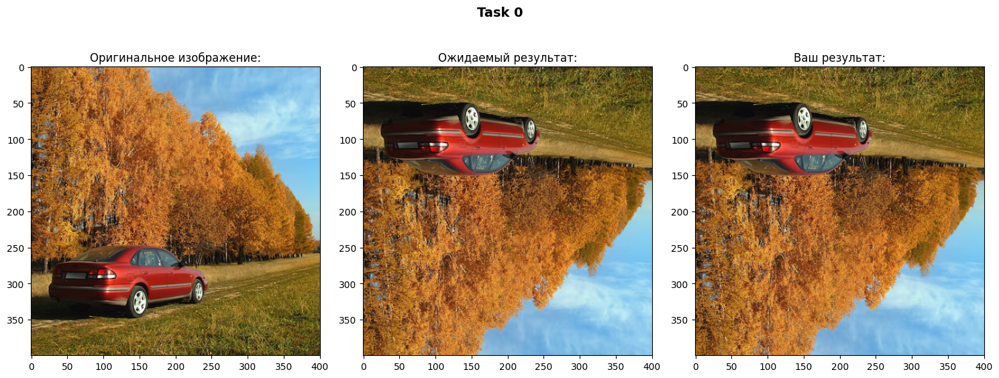

MSE(dst_image, result_image)=0.000, mse_threshold=0.100
✅ Задание выполнено!


In [57]:
def task_0_solution(image: np.ndarray) -> np.ndarray:
    # видим отражение по вертикальной оси
    # уже готовый пример
    return image[::-1, :, :]

visualize_and_compute_metric(0, task_0_solution)

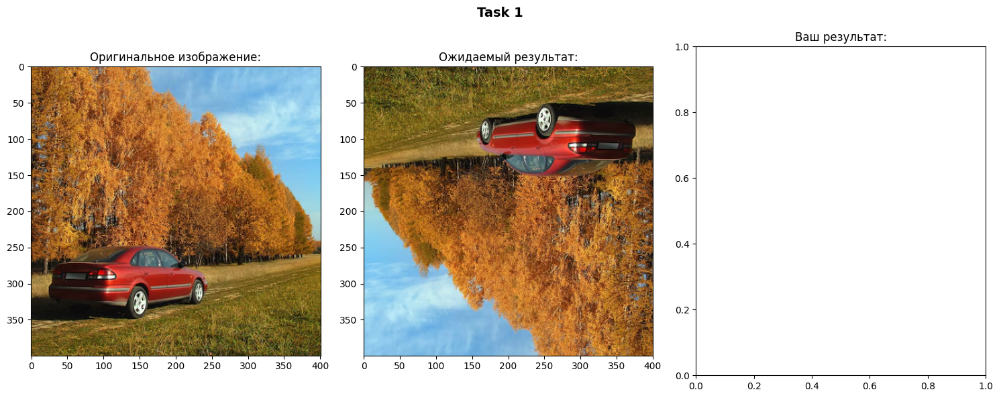

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [58]:
def task_1_solution(image: np.ndarray) -> np.ndarray:
    # your code here
    return None

visualize_and_compute_metric(1, task_1_solution)

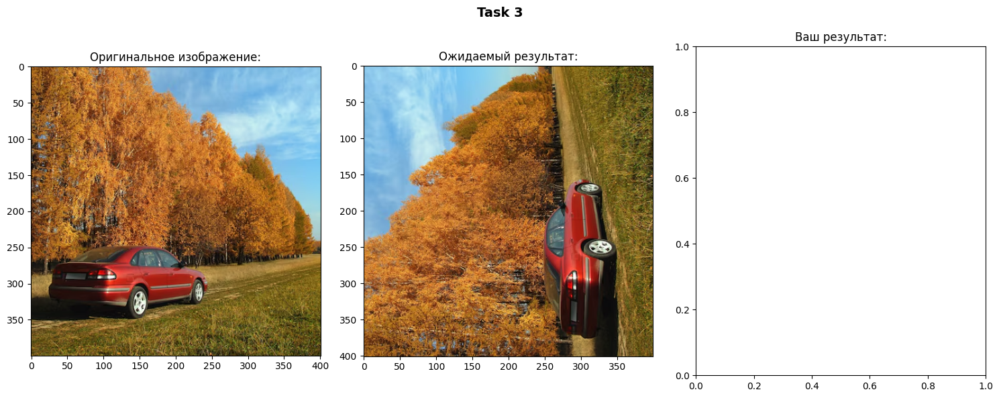

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [59]:
def task_3_solution(image: np.ndarray) -> np.ndarray:
    # your code here
    return None

visualize_and_compute_metric(3, task_3_solution)

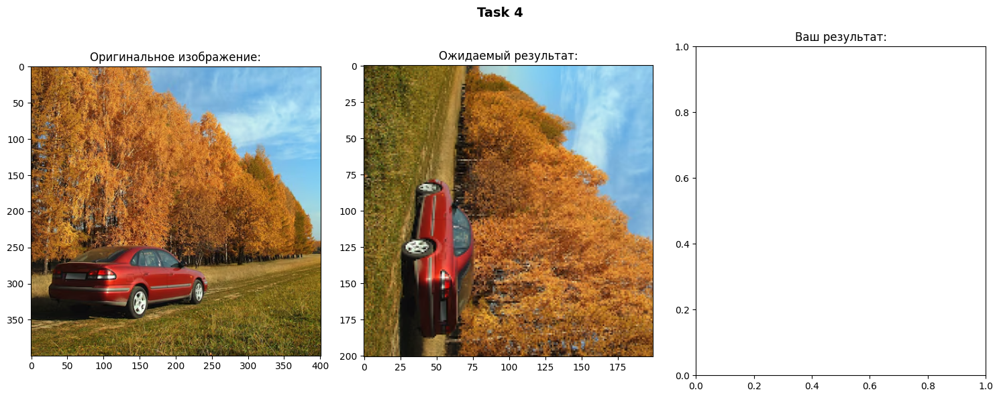

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [60]:
def task_4_solution(image: np.ndarray) -> np.ndarray:
    # только операции с numpy массивами!
    # your code here
    return None

visualize_and_compute_metric(4, task_4_solution)

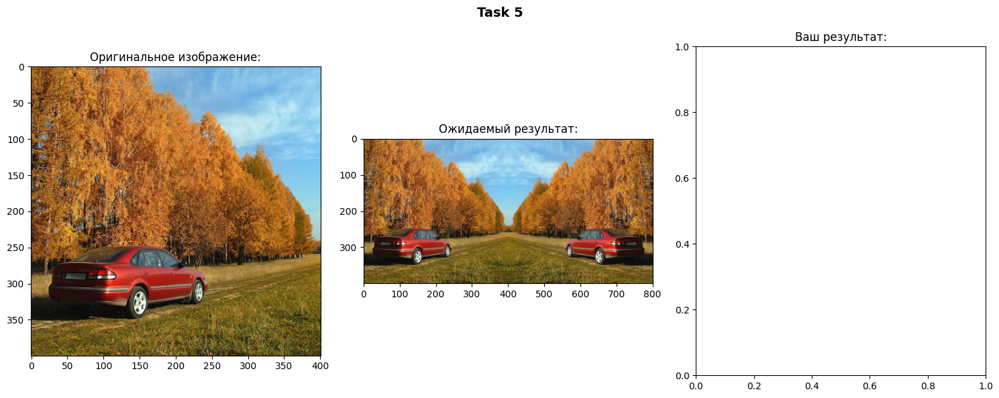

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [61]:
def task_5_solution(image: np.ndarray) -> np.ndarray:
    # только операции с numpy массивами!
    # your code here
    return None

visualize_and_compute_metric(5, task_5_solution)

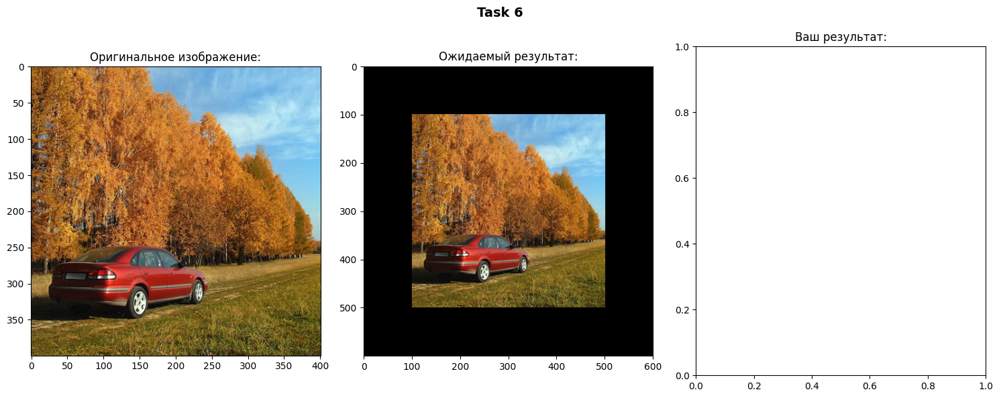

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [62]:
def task_6_solution(image: np.ndarray) -> np.ndarray:
    # только операции с numpy массивами!
    H = 100
    # your code here
    return None
   

visualize_and_compute_metric(6, task_6_solution)

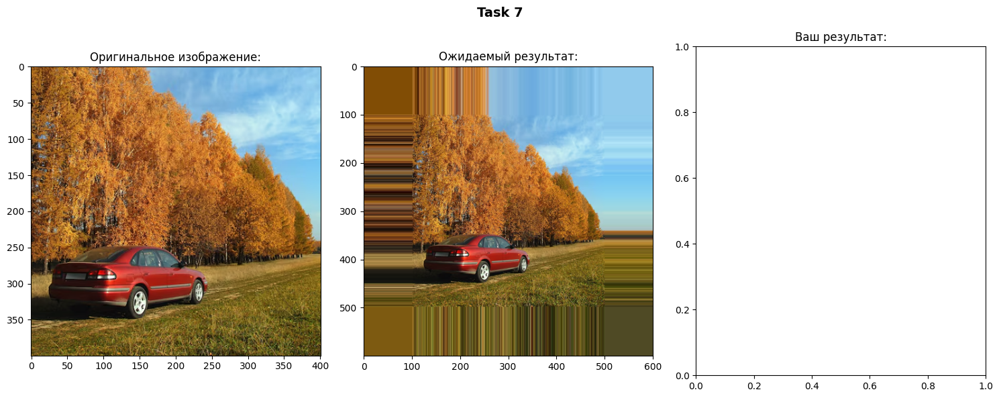

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [63]:
def task_7_solution(image: np.ndarray) -> np.ndarray:
    # только операции с numpy массивами!
    H = 100
    # your code here
    return None
   

visualize_and_compute_metric(7, task_7_solution)

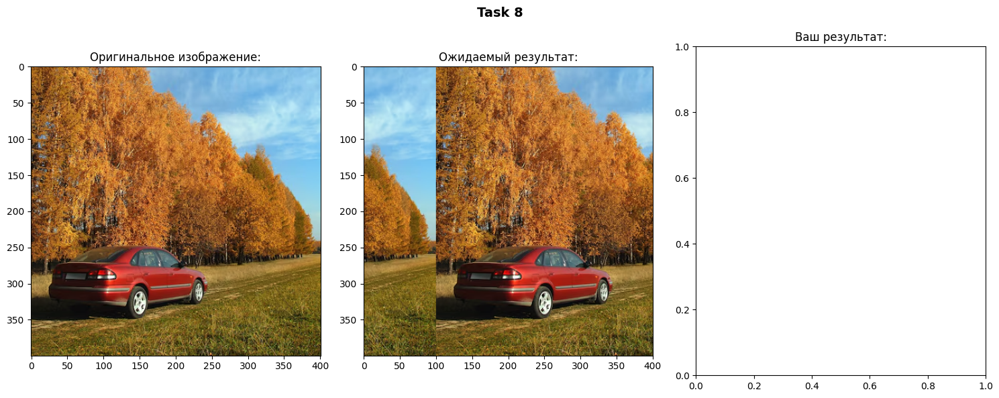

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [64]:
def task_8_solution(image: np.ndarray) -> np.ndarray:
    # только операции с numpy массивами!
    H = image.shape[1] // 4
    # your code here
    return None
   

visualize_and_compute_metric(8, task_8_solution)

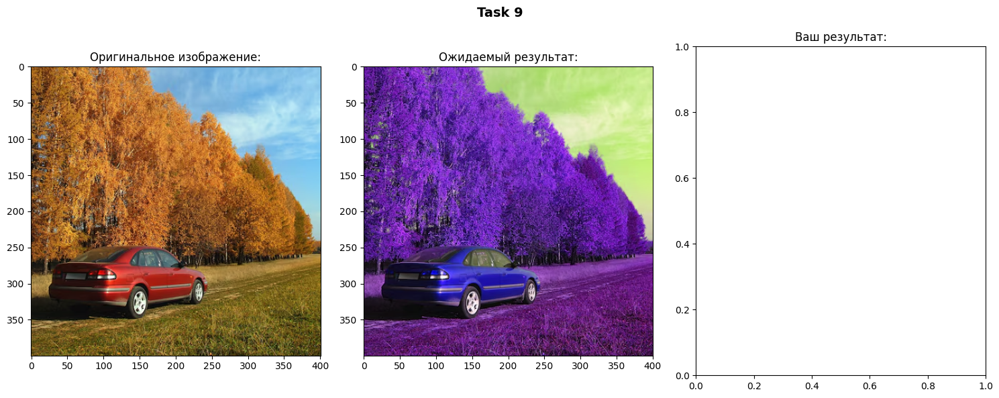

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [65]:
def task_9_solution(image: np.ndarray) -> np.ndarray:
    # только операции с numpy массивами!
    # your code here
    return None
   

visualize_and_compute_metric(9, task_9_solution)

## 2. Opencv, цветовые трансформации.

В некоторых заданиях использованные константы вам даны, в других же их вам нужно будет их вычислить. В таком случае приложите функцию которая находит нужные константы по двум изображениям или напишите, как вы подбирали эти константы эмпирически

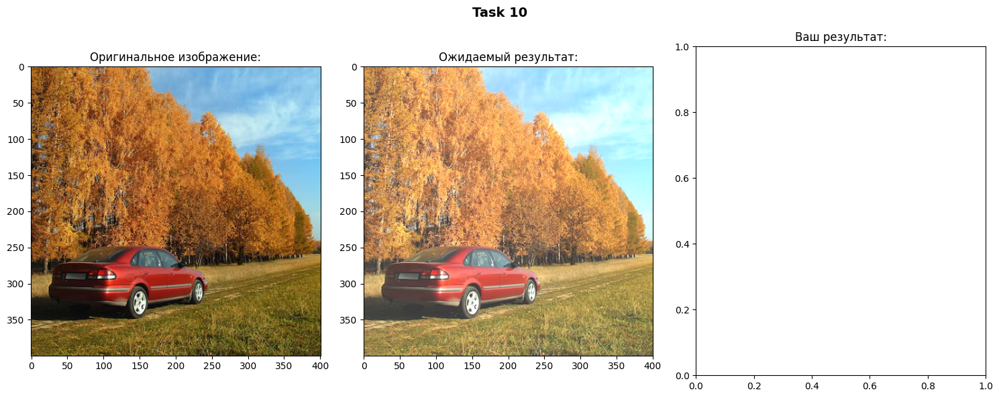

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [66]:
def task_10_solution(image: np.ndarray) -> np.ndarray:
    H = 50
    # your code here
    return None
   

visualize_and_compute_metric(10, task_10_solution)

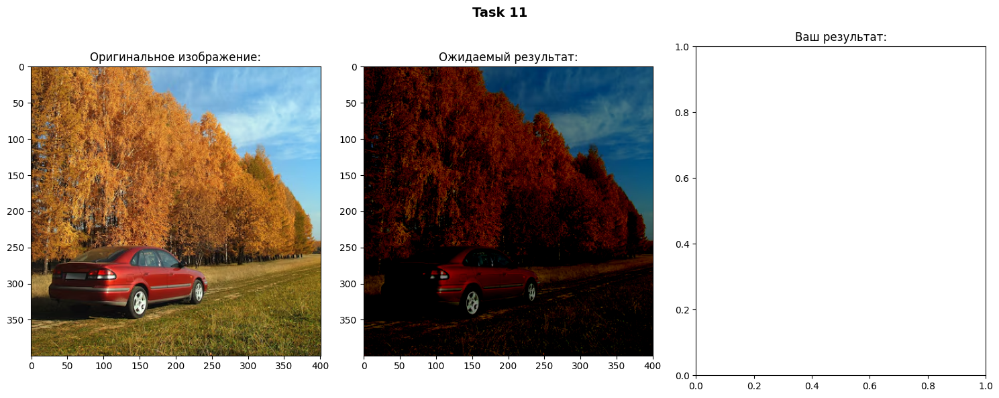

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [67]:
def task_11_solution(image: np.ndarray) -> np.ndarray:
    # Похоже на task10, но константу придется найти самостоятельно
    # your code here
    return None
   

visualize_and_compute_metric(11, task_11_solution)

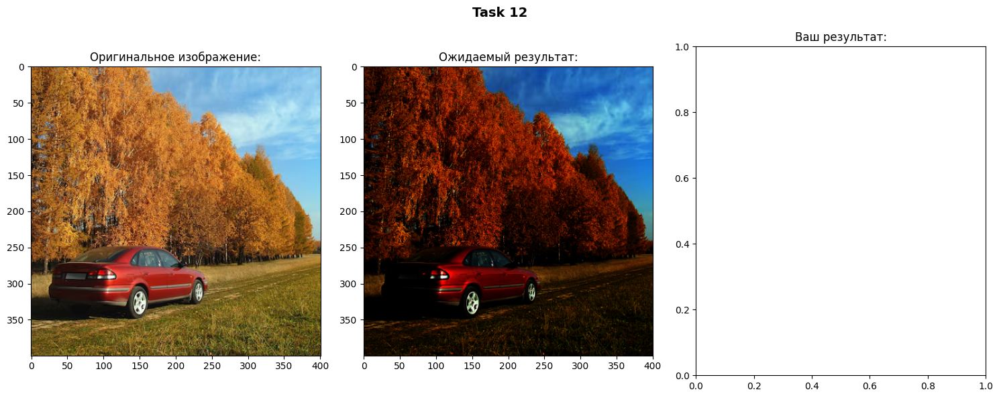

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [68]:
def task_12_solution(image: np.ndarray) -> np.ndarray:
    H = 3.0
    # your code here
    return None
   

visualize_and_compute_metric(12, task_12_solution)

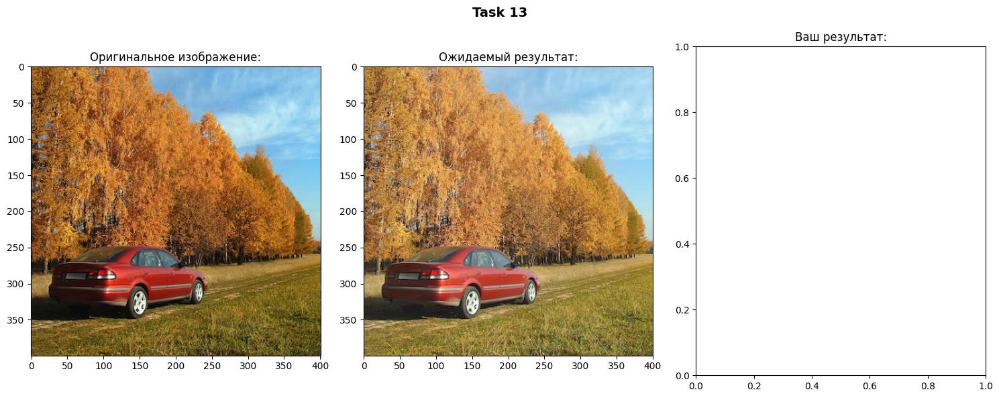

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [69]:
def task_13_solution(image: np.ndarray) -> np.ndarray:
    # Похоже на task12, но константу придется найти самостоятельно
    # your code here
    return None
   

visualize_and_compute_metric(13, task_13_solution)

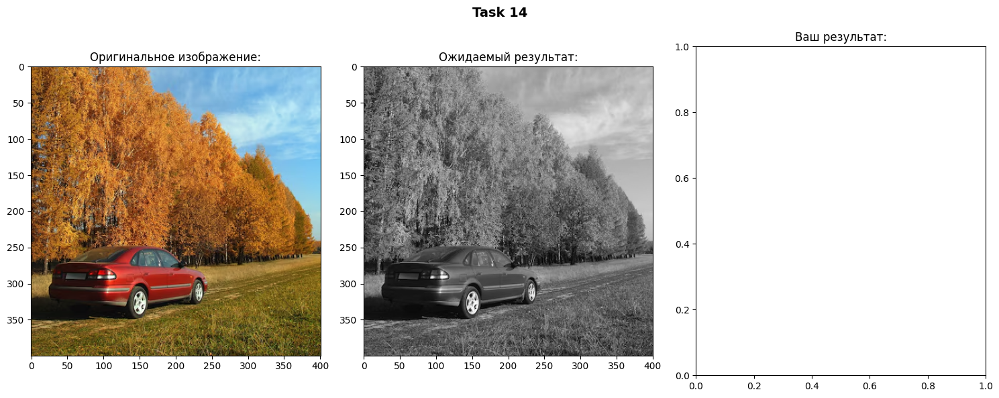

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [70]:
def task_14_solution(image: np.ndarray) -> np.ndarray:
    # return cv2.cvtColor(image, ?????????)
    return None
   

visualize_and_compute_metric(14, task_14_solution)

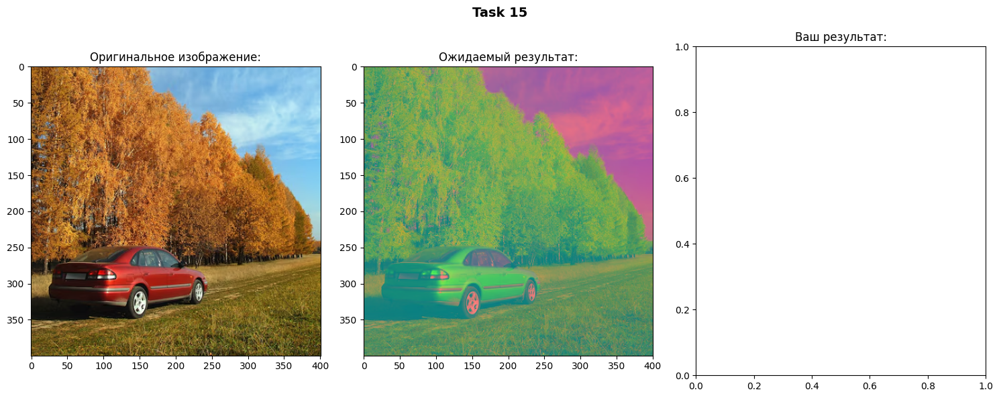

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [72]:
def task_15_solution(image: np.ndarray) -> np.ndarray:
    # return cv2.cvtColor(image, ???)
    return None
   

visualize_and_compute_metric(15, task_15_solution)

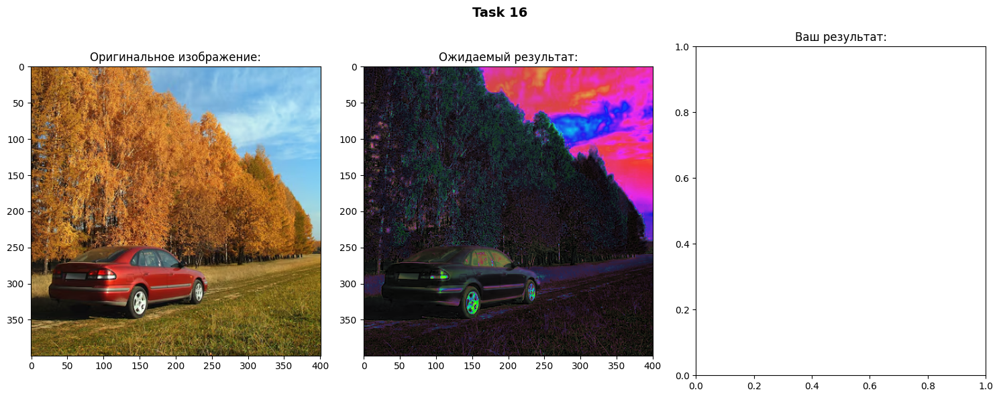

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [73]:
def task_16_solution(image: np.ndarray) -> np.ndarray:
    # return cv2.cvtColor(image, ???)
    return None
   

visualize_and_compute_metric(16, task_16_solution)

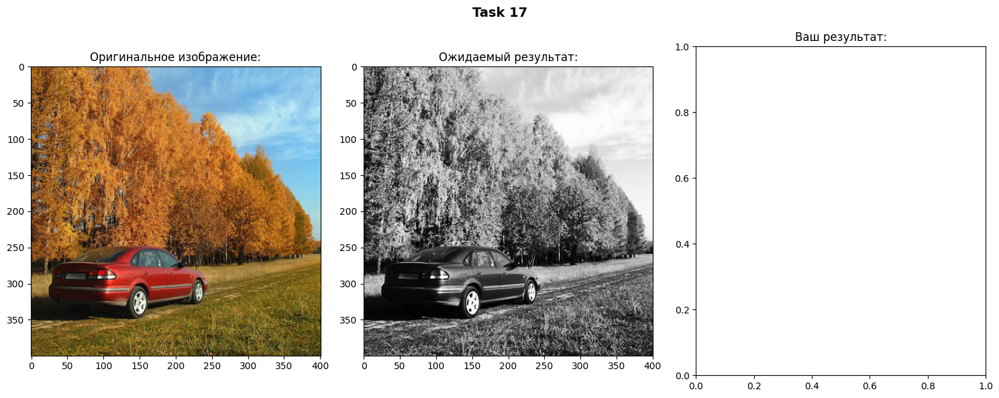

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [74]:
def task_17_solution(image: np.ndarray) -> np.ndarray:
    tmp = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    # Посмотрите на гистограмму-распредление писелей, преобразовываться будет далее только tmp
    # your code here
    return None
   

visualize_and_compute_metric(17, task_17_solution)

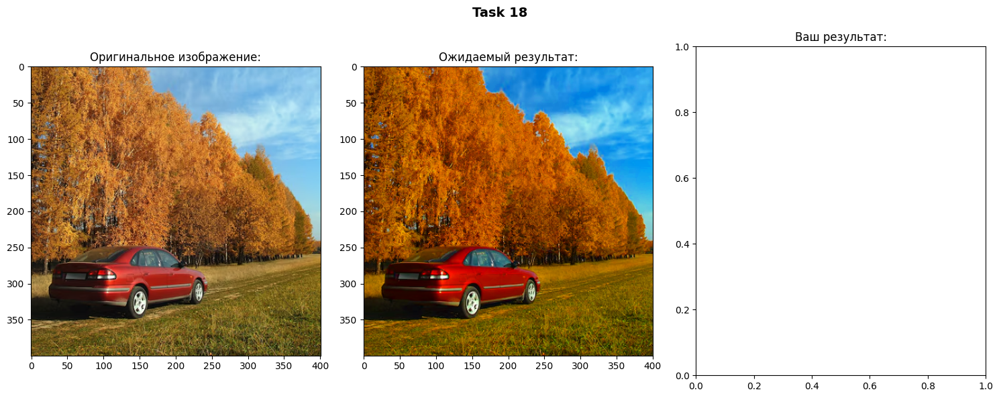

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [75]:
def task_18_solution(image: np.ndarray) -> np.ndarray:
    factor = 2
    # your code here
    return None

   

visualize_and_compute_metric(18, task_18_solution)


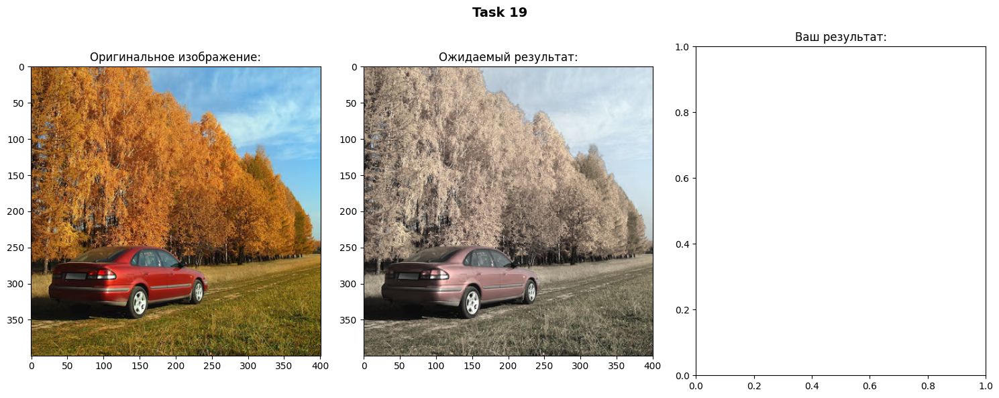

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [76]:
def task_19_solution(image: np.ndarray) -> np.ndarray:
    # factor = ???
    # your code here
    return None
   

visualize_and_compute_metric(19, task_19_solution)

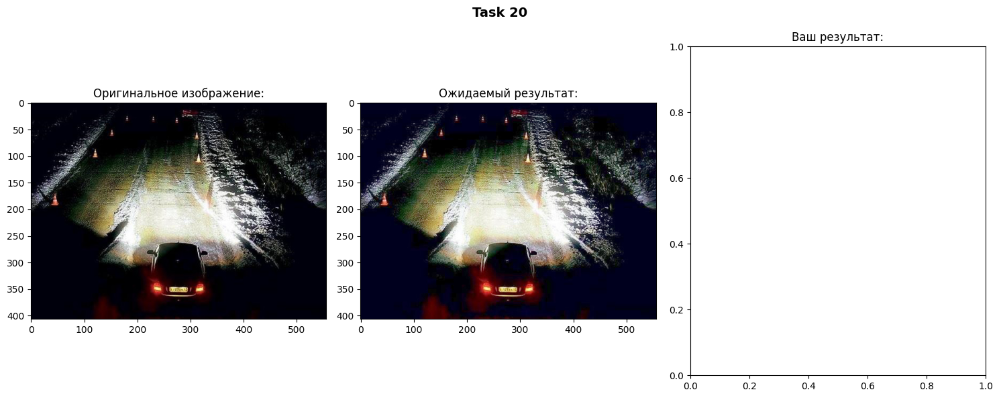

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [77]:
def task_20_solution(image: np.ndarray) -> np.ndarray:
    # image_hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    # h, s, v = cv2.split(image_hsv)
    # lt = ???
    # v = cv2.LUT(v, lt)
    # image_hsv = np.stack([h, s, v], axis=-1)
    # return cv2.cvtColor(image_hsv, cv2.COLOR_HSV2RGB)

    return None
   

visualize_and_compute_metric(20, task_20_solution)

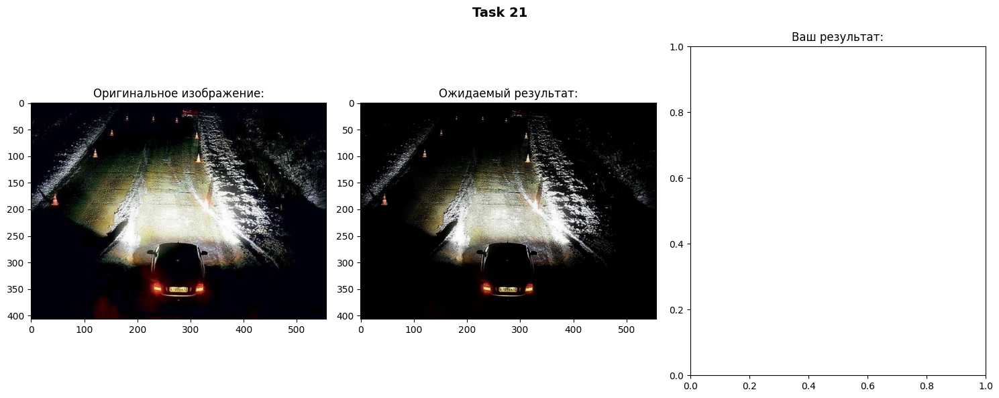

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [78]:
def task_21_solution(image: np.ndarray) -> np.ndarray:
    # image_hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    # h, s, v = cv2.split(image_hsv)
    # lt = ???
    # v = cv2.LUT(v, lt)
    # image_hsv = np.stack([h, s, v], axis=-1)
    # return cv2.cvtColor(image_hsv, cv2.COLOR_HSV2RGB)

    return None
   

visualize_and_compute_metric(21, task_21_solution)

## 3. Opencv, морфологии и свертки

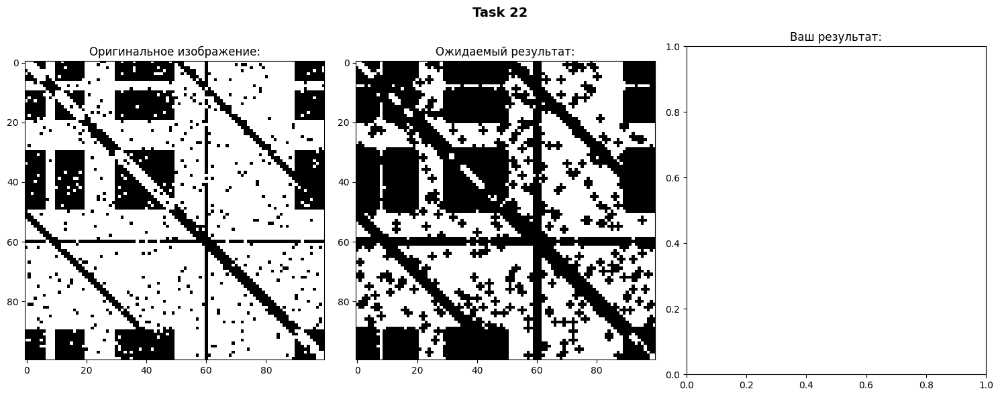

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [79]:
def task_22_solution(image: np.ndarray) -> np.ndarray:
    # kernel = np.array([
    #     [0, 1, 0],
    #     [1, 1, 1],
    #     [0, 1, 0]
    # ]).astype(np.uint8)
    # return cv2.morphologyEx(image, ???, kernel)
    return None
   

visualize_and_compute_metric(22, task_22_solution)

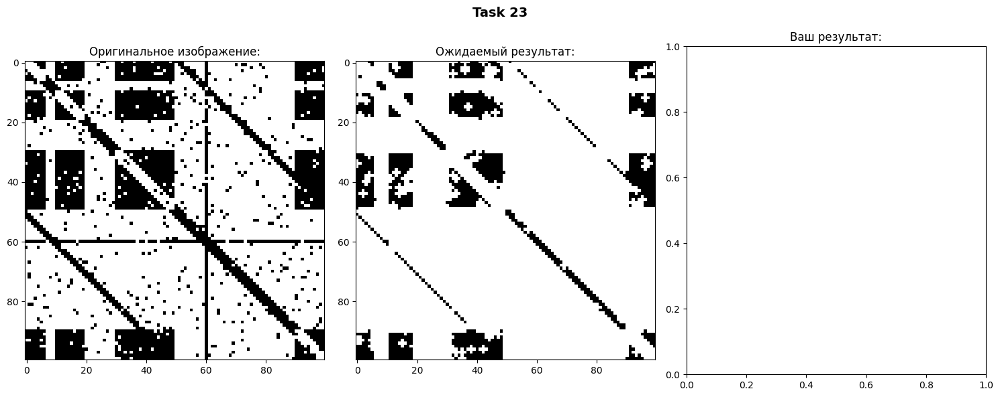

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [80]:
def task_23_solution(image: np.ndarray) -> np.ndarray:
    # kernel = np.array([
    #     [0, 1, 0],
    #     [1, 1, 1],
    #     [0, 1, 0]
    # ]).astype(np.uint8)
    # return cv2.morphologyEx(image, ???, kernel)
    return None
   

visualize_and_compute_metric(23, task_23_solution)

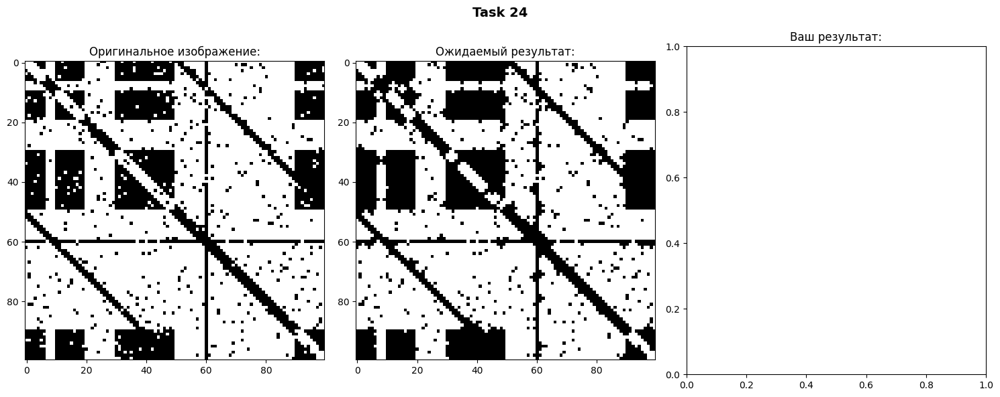

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [81]:
def task_24_solution(image: np.ndarray) -> np.ndarray:
    # kernel = np.array([
    #     [0, 1, 0],
    #     [1, 1, 1],
    #     [0, 1, 0]
    # ]).astype(np.uint8)
    # return cv2.morphologyEx(image, ???, kernel)
    return None
   

visualize_and_compute_metric(24, task_24_solution)

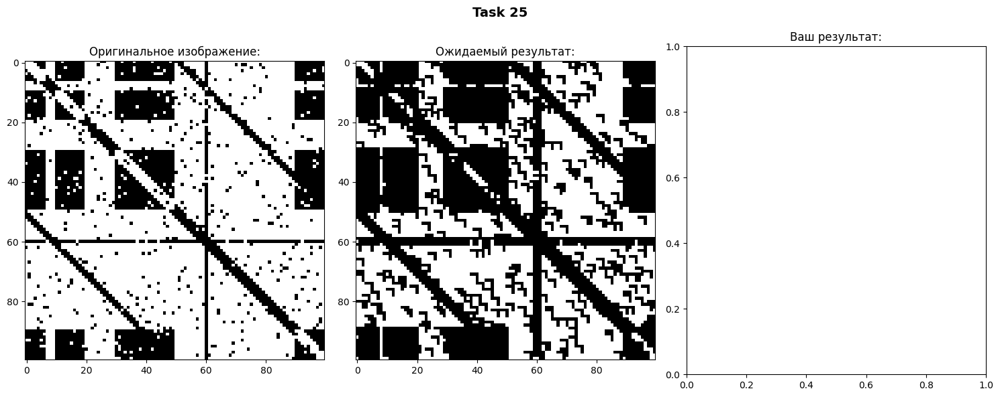

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [82]:
def task_25_solution(image: np.ndarray) -> np.ndarray:
    # kernel = np.array([
    #     ???
    # ]).astype(np.uint8)
    # return cv2.morphologyEx(image, ???, kernel)
    return None
   

visualize_and_compute_metric(25, task_25_solution)

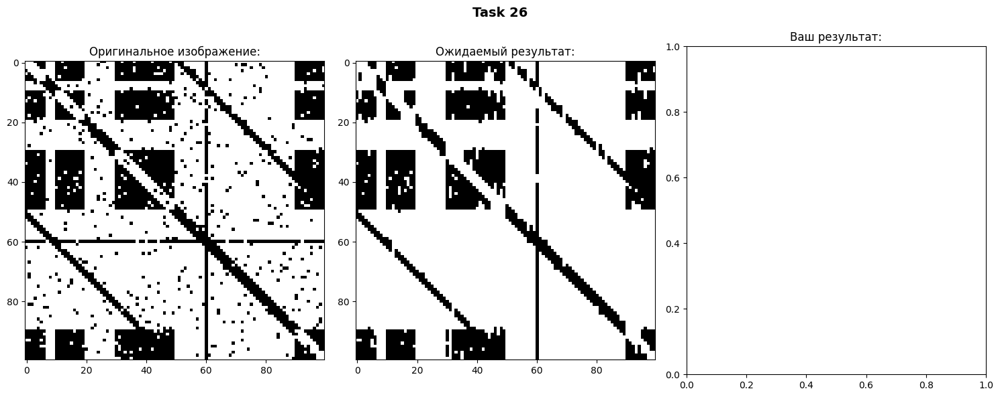

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [83]:
def task_26_solution(image: np.ndarray) -> np.ndarray:
    # kernel = np.array([
    #     ???
    # ]).astype(np.uint8)
    # return cv2.morphologyEx(image, ???, kernel, iterations=???)
    return None
   

visualize_and_compute_metric(26, task_26_solution)

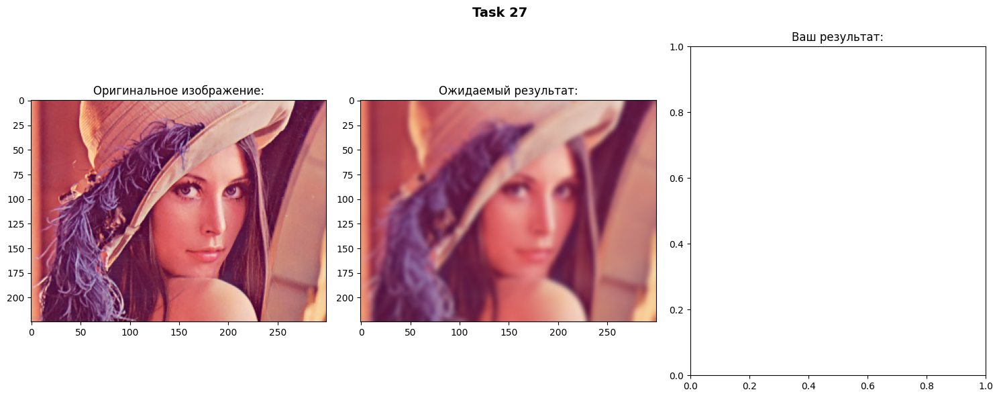

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [84]:
def task_27_solution(image: np.ndarray) -> np.ndarray:
    # K = 13
    # return cv2.???(image, (K, K), 0)
    return None
    

visualize_and_compute_metric(27, task_27_solution)

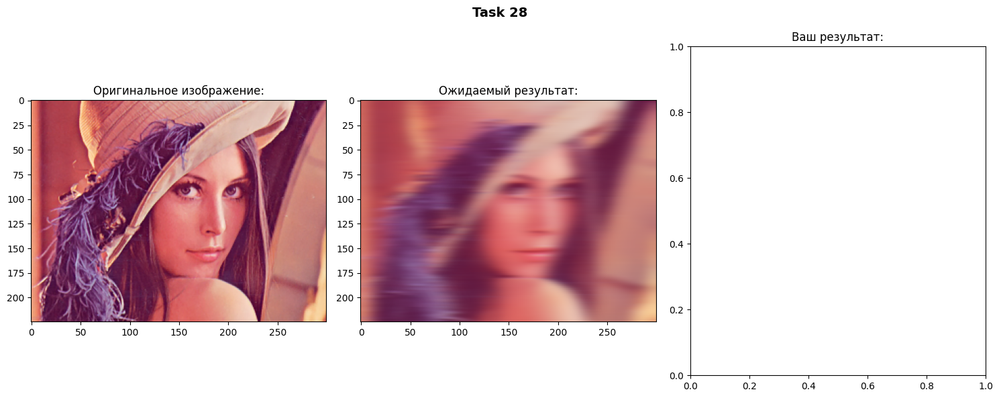

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [85]:
def task_28_solution(image: np.ndarray) -> np.ndarray:
    K = 51
    # your code here
    return None
    
visualize_and_compute_metric(28, task_28_solution)

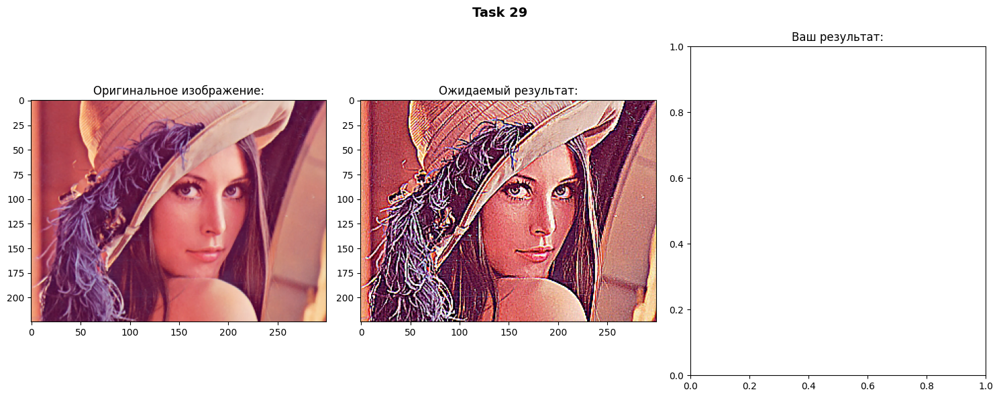

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [86]:
def task_29_solution(image: np.ndarray) -> np.ndarray:
    # составьте СЛАY решением которой будет sharpen_kernel и затем решите ее c помощью numpy.linalg
    # sharpen_kernel = ??? (3x3)
    # sharpen_kernel -= sharpen_kernel.mean()
    # sharpen_kernel[1, 1] += 1
    # return cv2.filter2D(image, -1, sharpen_kernel)
    return None

visualize_and_compute_metric(29, task_29_solution)

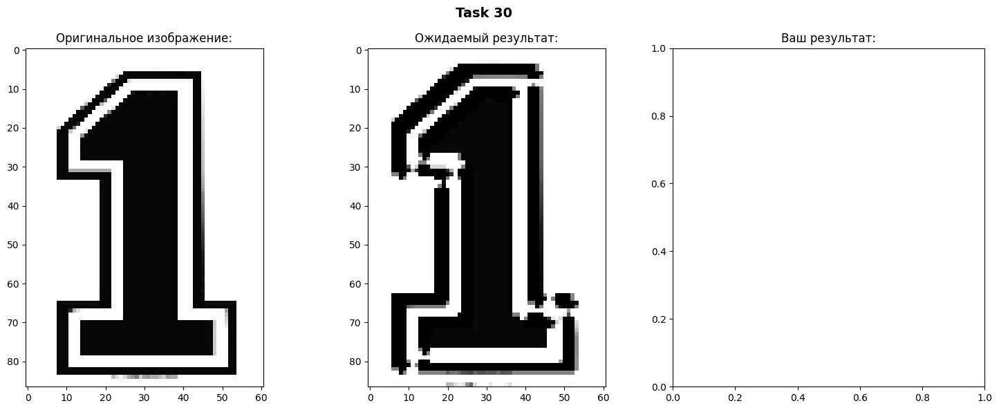

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [87]:
def task_30_solution(image: np.ndarray) -> np.ndarray:
    # sharpen_kernel = Unknown shape!
    # sharpen_kernel -= sharpen_kernel.mean()
    # sharpen_kernel[1, 1] += 1
    # return cv2.filter2D(image, -1, sharpen_kernel)
    # Вспомните, что свертка - это поэлементное умножение в пространстве fft! 
    # Найдите ядро, с которым была произведена свертка изначального изображения
    return None

visualize_and_compute_metric(30, task_30_solution)

## 4. OpenCV Произвольные преобразования из лекции или семинара

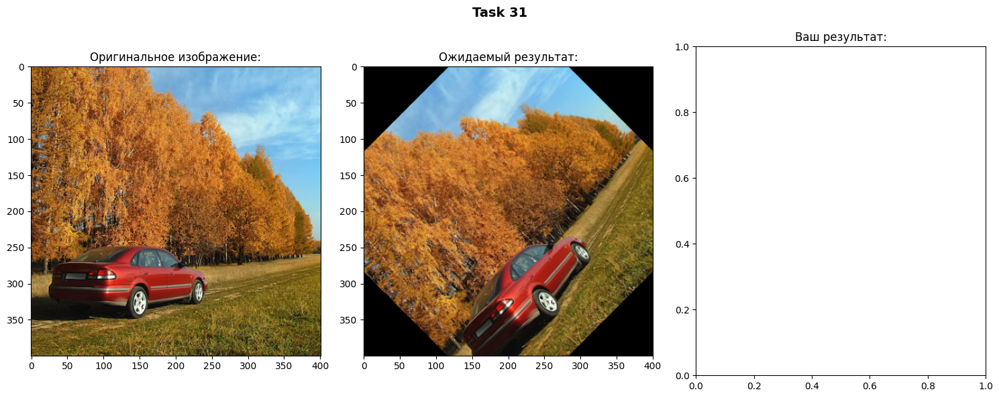

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [88]:
def task_31_solution(image: np.ndarray) -> np.ndarray:
    A = 45
    # rot_mat = cv2.getRotationMatrix2D(?, ?, ?)
    # result = cv2.warpAffine(image, rot_mat, image.shape[1::-1], flags=cv2.INTER_LINEAR)
    # return result
    return None

visualize_and_compute_metric(31, task_31_solution)

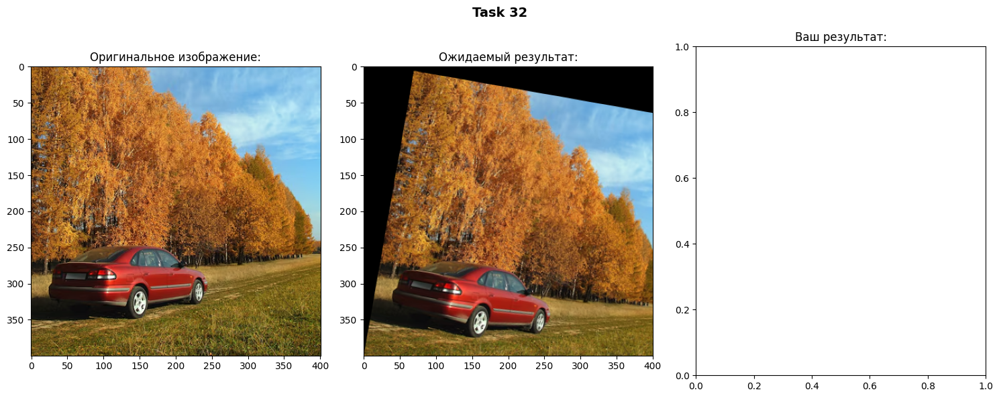

MSE(dst_image, result_image)=inf, mse_threshold=0.100
❌ Задание не выполнено!


In [89]:
def task_32_solution(image: np.ndarray) -> np.ndarray:
    # your code here
    return None

visualize_and_compute_metric(32, task_32_solution)

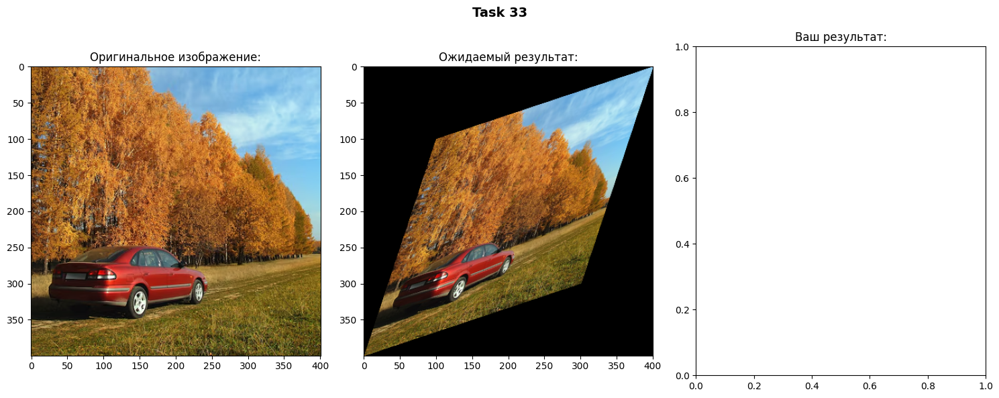

MSE(dst_image, result_image)=inf, mse_threshold=2.000
❌ Задание не выполнено!


In [90]:
def task_33_solution(image: np.ndarray) -> np.ndarray:
    H = 100
    # your code here
    return None


visualize_and_compute_metric(33, task_33_solution, mse_threshold=2)

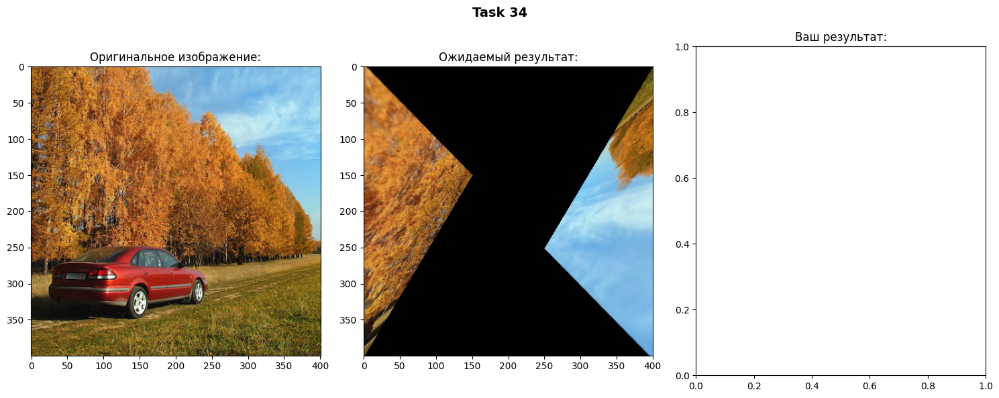

MSE(dst_image, result_image)=inf, mse_threshold=2.000
❌ Задание не выполнено!


In [91]:
def task_34_solution(image: np.ndarray) -> np.ndarray:
    # Случился баг. Поймите что это за баг и воспроизведите его!
    H = 150
    # your code here
    return None


visualize_and_compute_metric(34, task_34_solution, mse_threshold=2)

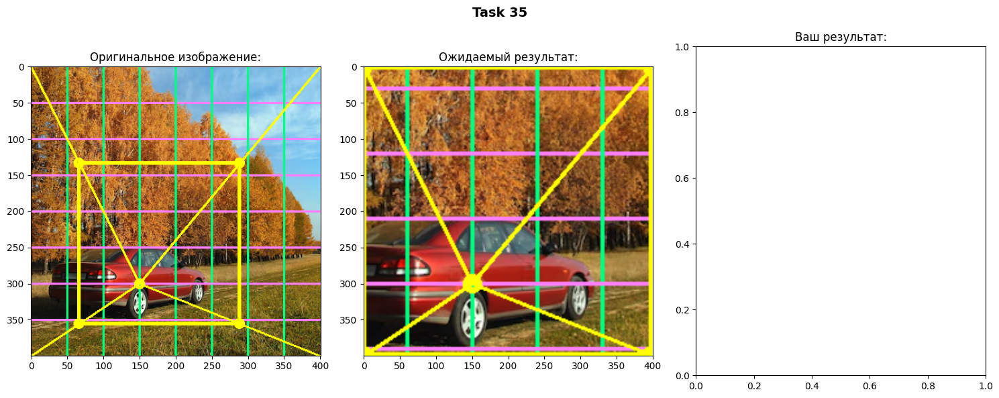

MSE(dst_image, result_image)=inf, mse_threshold=10.000
❌ Задание не выполнено!


In [92]:
def task_35_solution(image: np.ndarray) -> np.ndarray:
    # Вырежем фрагмент из картинки с помощью remap
    center_x, center_y = 150, 300
    scale_factor = 1.8

    h, w = image.shape[:2]
    # TODO
    # ....
    # return cv2.remap(image, xx_new, yy_new, cv2.INTER_LINEAR)
    return None


visualize_and_compute_metric(35, task_35_solution, mse_threshold=10)

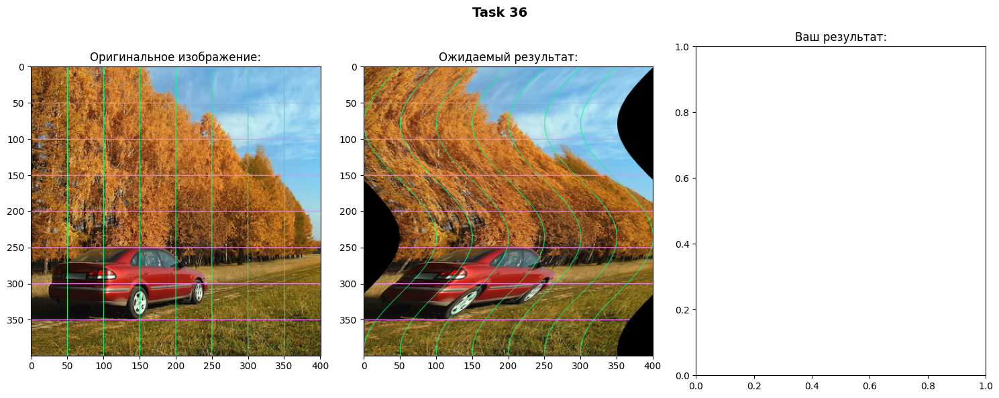

MSE(dst_image, result_image)=inf, mse_threshold=10.000
❌ Задание не выполнено!


In [93]:
def task_36_solution(image: np.ndarray) -> np.ndarray:
    # Сделаем эффект волнообразного "смятия" с помощью remap
    # Обратите внимание на заливку черным цветом пикселей в районах границы.
    def dx(x: np.ndarray, y: np.ndarray) -> np.ndarray:
        return np.sin(y / 50) * 50
                      
    # TODO
    # ...
    # return cv2.remap(image, xx_new, yy_new, cv2.INTER_LINEAR)
    return None

visualize_and_compute_metric(36, task_36_solution, mse_threshold=10)

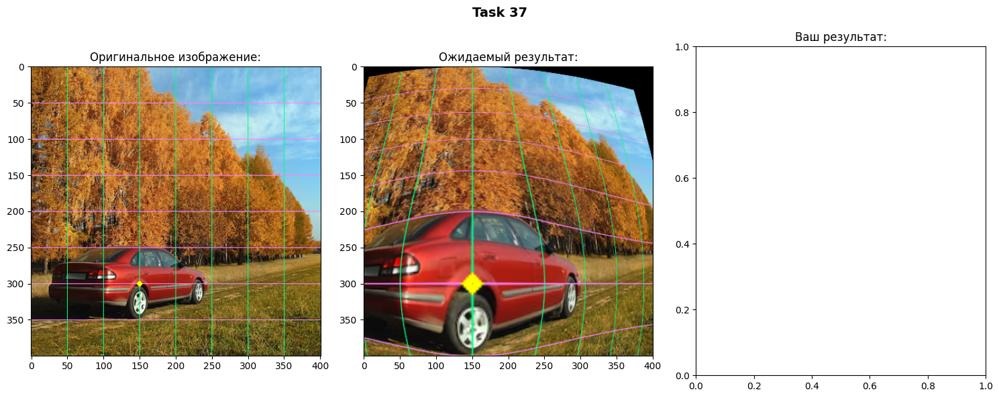

MSE(dst_image, result_image)=inf, mse_threshold=10.000
❌ Задание не выполнено!


In [94]:
def task_37_solution(image: np.ndarray) -> np.ndarray:
    # Сделаем эффект "рыбий глаз"
    def dr(r: np.ndarray, alpha: float = 0.01, scale: float = 0.25) -> np.ndarray:
        return (r + alpha * (r ** 2)) * scale
                    
    center_x, center_y = 150, 300

    # TODO
    # ...
    # return cv2.remap(image, xx_new, yy_new, cv2.INTER_LINEAR)
    return None


visualize_and_compute_metric(37, task_37_solution, mse_threshold=10)